# Customer2Vec

In this notebook, we demonstrate how to learn embeddings for customers from transactional data using Doc2Vec. Each customer is viwed as a document, orders as sentences, and products as words. We also compare Customer2Vec with the baseline representations obtained using k-means on manually designed features.

### Data
We use an external dataset from the Instacart Market Basket Analysis competition (see [datasets](https://github.com/ikatsov/tensor-house/blob/master/resources/datasets.md)). Please download and unzip the dataset to 'data' folder before running this notebook.

### References
1. Arora S., Warrier D. -- Decoding Fashion Contexts Using Word Embeddings, 2016
1. Stiebellehner S., Wang J, Yuan S. -- Learning Continuous User Representations through Hybrid Filtering with doc2vec, 2017

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from tqdm import tqdm_notebook as tqdm
import numpy as np
import os
from sklearn.manifold import TSNE

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn import preprocessing

pd.options.display.max_rows = 20
%matplotlib inline

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
pd.set_option('display.max_colwidth', 500)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import warnings
warnings.filterwarnings("ignore")
import glob
from IPython.display import display, HTML

import multiprocessing as mp
print('Number of CPU cores:', mp.cpu_count())

Number of CPU cores: 2


In [2]:
from google.colab import files
uploaded = files.upload()

Saving clean_data.csv to clean_data.csv


In [3]:
import io
df = pd.read_csv(io.BytesIO(uploaded['clean_data.csv']))

# Step 1: Data Exploration and Preparation

In [4]:

df.head()

,case_nbr,prod_desc,system_age,total_inbounf_count,commodity_desc,total_activity_count,warranty_status,new_warranty_type,continent_cat,country_cat,date_delta
0,1.0,8.0,677.000000,4.0,1.0,9.0,0.0,9.0,2,39,283.0
1,2.0,4.0,1738.000000,3.0,1.0,7.0,1.0,4.0,5,26,288.0
2,3.0,7.0,692.562918,4.0,0.0,8.0,1.0,4.0,4,40,164.0
3,4.0,8.0,1075.000000,3.0,1.0,5.0,0.0,9.0,4,40,204.0
4,5.0,11.0,138.000000,3.0,0.0,5.0,0.0,9.0,4,40,258.0


# Step 3: Customer2Vec Using Doc2Vec

In this and next section, we are learning and exploring the customer semantic space using Doc2Vec.

### Step 3.1: Data Preparation

In [5]:

df.sort_values(by=['case_nbr'], inplace=True)
combined_customer = pd.DataFrame(df, columns=["case_nbr"])
todrop = ['case_nbr']
df.drop(todrop, axis='columns', inplace = True)
combined_customer["all_cases"] = df.apply(lambda row: ' '.join(row.values.astype(str)), axis=1)
combined_customer.reset_index(inplace=True)
combined_customer.case_nbr = combined_customer.case_nbr.astype(str)
todrop = ['index']
combined_customer.drop(todrop, axis='columns', inplace = True)
combined_customer.head(10)

,case_nbr,all_cases
0,1.0,8.0 677.0 4.0 1.0 9.0 0.0 9.0 2.0 39.0 283.0
1,2.0,4.0 1738.0 3.0 1.0 7.0 1.0 4.0 5.0 26.0 288.0
2,3.0,7.0 692.5629180365038 4.0 0.0 8.0 1.0 4.0 4.0 40.0 164.0
3,4.0,8.0 1075.0 3.0 1.0 5.0 0.0 9.0 4.0 40.0 204.0
4,5.0,11.0 138.0 3.0 0.0 5.0 0.0 9.0 4.0 40.0 258.0
5,6.0,8.0 1799.0 2.0 1.0 4.0 0.0 9.0 1.0 21.0 190.0
6,7.0,8.0 123.0 2.0 1.0 3.0 0.0 9.0 4.0 40.0 63.0
7,8.0,8.0 1324.0 3.0 0.0 4.0 0.0 9.0 6.0 10.0 113.0
8,9.0,7.0 1014.0 3.0 0.0 5.0 0.0 9.0 4.0 40.0 231.0
9,11.0,8.0 1049.0 2.0 0.0 7.726491068725402 0.0 0.0 6.0 24.0 170.0


### Step 3.2: Train Doc2Vec model

We use implementation from Gensim adjusting the following parameters:
* documents = users (each user is represented by a chronologically sorted list of products)
* window - Maximum distance between the current and predicted word within a sentence.
* vector_size - Dimensionality of the word vectors.
* min_count - Ignores all words with total frequency lower than this.

Note that model training can take a long time (10+ hours).

In [6]:
TRAIN_USER_MODEL = False    # True - create a new model, False - load a previosuly created model
MODEL_DIR = 'models'

if not os.path.exists(MODEL_DIR):
    os.makedirs(MODEL_DIR)

In [8]:
from gensim.models.doc2vec import TaggedDocument, Doc2Vec
import gensim

embeddings_dim = 128    # dimensionality of user representation

filename = f'customer2vec.{embeddings_dim}d.model'
if TRAIN_USER_MODEL:

    class TaggedDocumentIterator(object):
        def __init__(self, df):
           self.df = df
        def __iter__(self):
            for row in self.df.itertuples():
                yield TaggedDocument(words=dict(row._asdict())['all_cases'].split(),tags=[dict(row._asdict())['case_nbr']])

    it = TaggedDocumentIterator(combined_customer)

    doc_model = gensim.models.Doc2Vec(vector_size=embeddings_dim, 
                                      window=5, 
                                      min_count=10, 
                                      workers=mp.cpu_count(),
                                      alpha=0.055, 
                                      min_alpha=0.055,
                                      epochs=120)   # use fixed learning rate

    train_corpus = list(it)

    doc_model.build_vocab(train_corpus)

    for epoch in tqdm(range(10)):
        doc_model.alpha -= 0.005                    # decrease the learning rate
        doc_model.min_alpha = doc_model.alpha       # fix the learning rate, no decay
        doc_model.train(train_corpus, total_examples=doc_model.corpus_count, epochs=doc_model.epochs)
        print('Iteration:', epoch)

    doc_model.save(filename)
    print(f'Model saved to [{filename}]')
    
else:
    doc_model = Doc2Vec.load(filename)
    print(f'Model loaded from [{filename}]')

Model loaded from [customer2vec.128d.model]


In [9]:
vocab_doc = list(doc_model.dv.index_to_key)
doc_vector_dict = {arg:doc_model.docvecs[arg] for arg in vocab_doc}
X_doc = pd.DataFrame(doc_vector_dict).T.values
X_doc.shape, len(vocab_doc), combined_customer["case_nbr"].nunique()


((18018, 128), 18018, 18018)

### Step 3.3: Visualize the Customer Semantic Space Using t-SNE

In [27]:
from sklearn.metrics import pairwise_distances

distance_matrix_doc = pairwise_distances(X_doc, X_doc, metric='cosine', n_jobs=-1)
tsne_doc = TSNE(metric="precomputed", init="random", n_components=2, verbose=1, perplexity=500, n_iter=1000)
tsne_results_doc = tsne_doc.fit_transform(distance_matrix_doc)

[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 18018 samples in 4.499s...
[t-SNE] Computed neighbors for 18018 samples in 12.562s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18018
[t-SNE] Computed conditional probabilities for sample 2000 / 18018
[t-SNE] Computed conditional probabilities for sample 3000 / 18018
[t-SNE] Computed conditional probabilities for sample 4000 / 18018
[t-SNE] Computed conditional probabilities for sample 5000 / 18018
[t-SNE] Computed conditional probabilities for sample 6000 / 18018
[t-SNE] Computed conditional probabilities for sample 7000 / 18018
[t-SNE] Computed conditional probabilities for sample 8000 / 18018
[t-SNE] Computed conditional probabilities for sample 9000 / 18018
[t-SNE] Computed conditional probabilities for sample 10000 / 18018
[t-SNE] Computed conditional probabilities for sample 11000 / 18018
[t-SNE] Computed conditional probabilities for sample 12000 / 18018
[t-SNE] Computed conditional probabilities for 

In [28]:
tsne_doc = pd.DataFrame()
tsne_doc['tsne-2d-one'] = tsne_results_doc[:,0]
tsne_doc['tsne-2d-two'] = tsne_results_doc[:,1]

<Figure size 1600x1600 with 0 Axes>

<Axes: xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

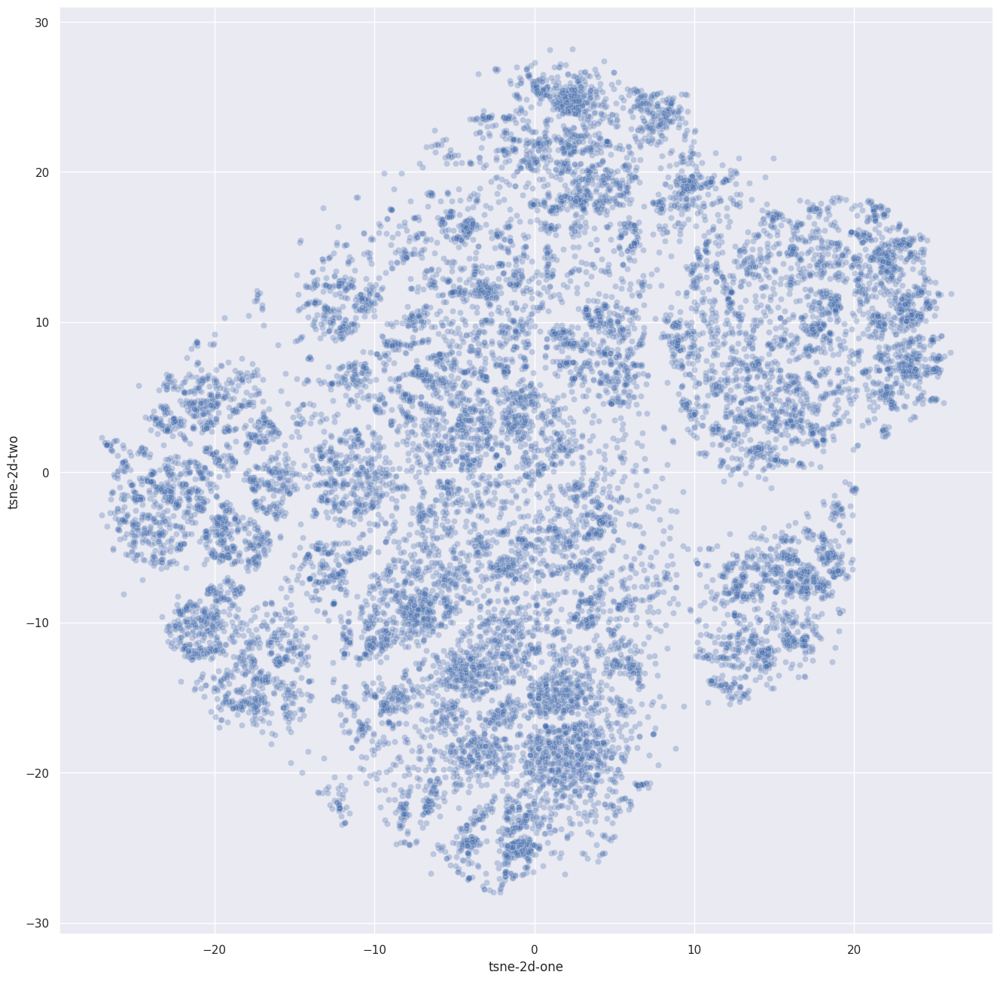

In [29]:
plt.figure(figsize=(16,16))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    data=tsne_doc,
    legend="full",
    alpha=0.3
)
plt.show()

### Step 3.4: Segmentation in the Customer Semantic Space Using t-SNE

In [11]:
def cluster_cosine(X, k):
    # normalization is equivalent to cosine distance
    return KMeans(n_clusters=k).fit(preprocessing.normalize(X_doc)).labels_.astype(float)

silhouette_list = []
for k in tqdm(range(2, 22, 1)):
    latent_clusters = cluster_cosine(X_doc, k)
    silhouette_avg = silhouette_score(X_doc, latent_clusters, metric="cosine")
    silhouette_list.append(silhouette_avg)
    print(f'Silhouette score for {k} clusters is : {silhouette_avg:.4}')

  0%|          | 0/20 [00:00<?, ?it/s]

Silhouette score for 2 clusters is : 0.1103
Silhouette score for 3 clusters is : 0.1106
Silhouette score for 4 clusters is : 0.1112
Silhouette score for 5 clusters is : 0.104
Silhouette score for 6 clusters is : 0.1026
Silhouette score for 7 clusters is : 0.1146
Silhouette score for 8 clusters is : 0.107
Silhouette score for 9 clusters is : 0.1077
Silhouette score for 10 clusters is : 0.1079
Silhouette score for 11 clusters is : 0.1082
Silhouette score for 12 clusters is : 0.1127
Silhouette score for 13 clusters is : 0.1119
Silhouette score for 14 clusters is : 0.1054
Silhouette score for 15 clusters is : 0.09963
Silhouette score for 16 clusters is : 0.09866
Silhouette score for 17 clusters is : 0.1042
Silhouette score for 18 clusters is : 0.1032
Silhouette score for 19 clusters is : 0.09625
Silhouette score for 20 clusters is : 0.09846
Silhouette score for 21 clusters is : 0.1003


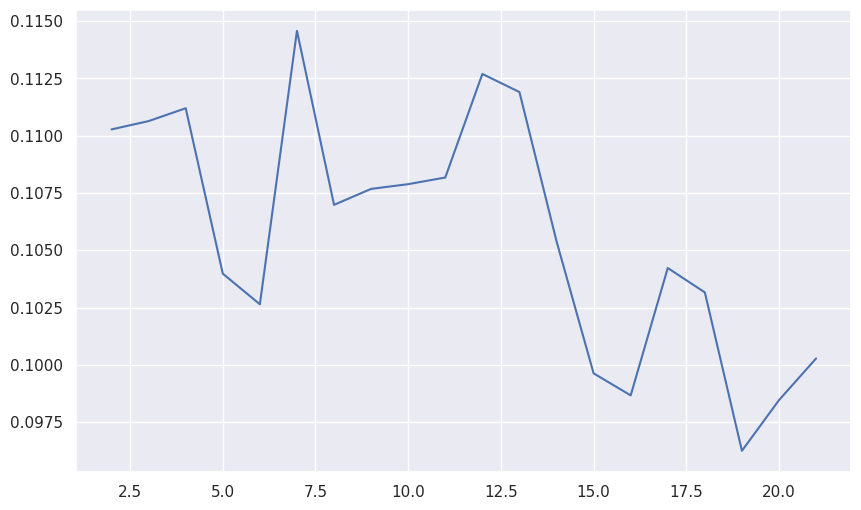

In [12]:
plt.figure(figsize=(10,6))
plt.plot(range(2,22,1), silhouette_list);

In [31]:
N_CLUSTER = 7

latent_clusters = cluster_cosine(X_doc, N_CLUSTER)
tsne_doc['cluster'] = latent_clusters

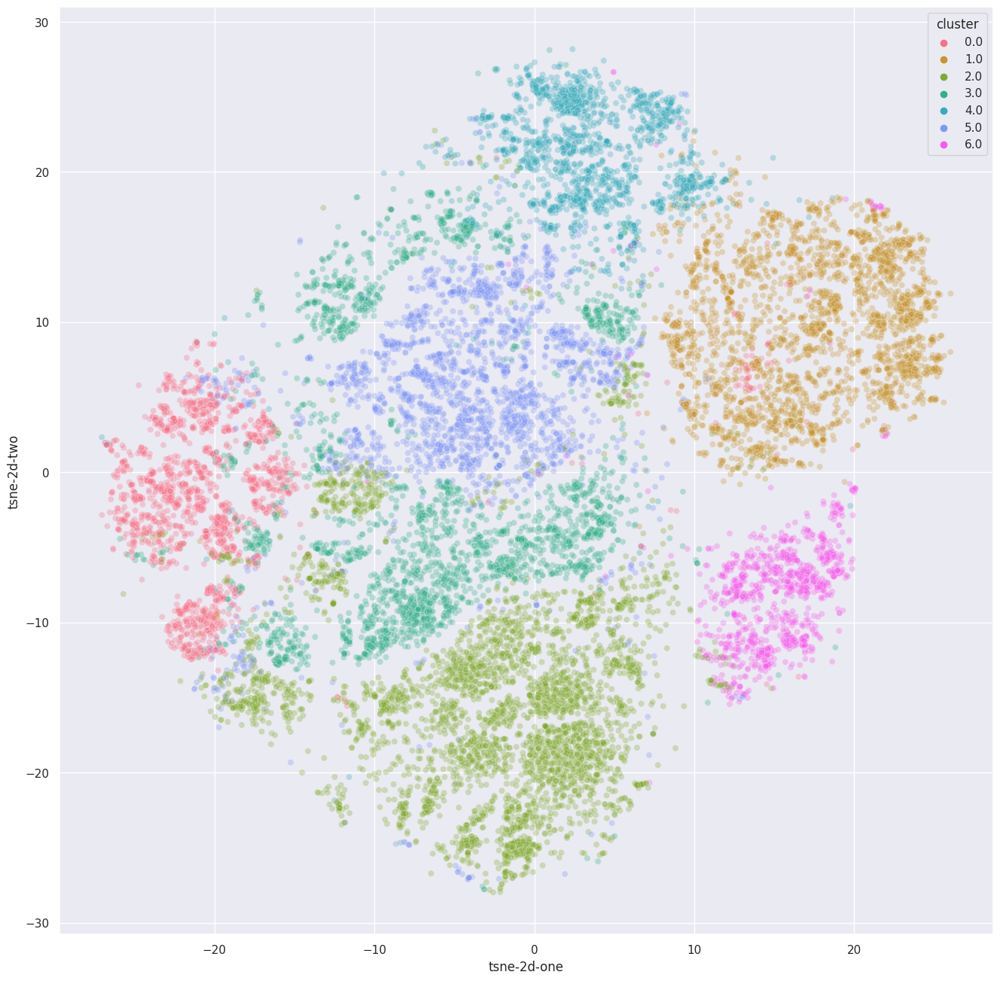

In [32]:
plt.figure(figsize=(16, 16))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue='cluster',
    palette=sns.color_palette("husl", tsne_doc['cluster'].nunique()),
    data=tsne_doc,
    legend="full",
    alpha=0.3
);
plt.show();

In [37]:
df["clusters"] = pd.Series(latent_clusters)

In [39]:
df.to_csv("128dembeddingClusters.csv", index=False)
files.download("128dembeddingClusters.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [10]:
from sklearn.metrics import pairwise_distances

distance_matrix_doc3D = pairwise_distances(X_doc, X_doc, metric='cosine', n_jobs=-1)
tsne_doc3D = TSNE(metric="precomputed", init="random", n_components=3, verbose=1, perplexity=500, n_iter=1000)
tsne_results_doc3D = tsne_doc3D.fit_transform(distance_matrix_doc3D)

[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 18018 samples in 3.884s...
[t-SNE] Computed neighbors for 18018 samples in 9.956s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18018
[t-SNE] Computed conditional probabilities for sample 2000 / 18018
[t-SNE] Computed conditional probabilities for sample 3000 / 18018
[t-SNE] Computed conditional probabilities for sample 4000 / 18018
[t-SNE] Computed conditional probabilities for sample 5000 / 18018
[t-SNE] Computed conditional probabilities for sample 6000 / 18018
[t-SNE] Computed conditional probabilities for sample 7000 / 18018
[t-SNE] Computed conditional probabilities for sample 8000 / 18018
[t-SNE] Computed conditional probabilities for sample 9000 / 18018
[t-SNE] Computed conditional probabilities for sample 10000 / 18018
[t-SNE] Computed conditional probabilities for sample 11000 / 18018
[t-SNE] Computed conditional probabilities for sample 12000 / 18018
[t-SNE] Computed conditional probabilities for s

In [33]:
tsne_doc3D = pd.DataFrame()
tsne_doc3D['tsne-3d-one'] = tsne_results_doc3D[:,0]
tsne_doc3D['tsne-3d-two'] = tsne_results_doc3D[:,1]
tsne_doc3D['tsne-3d-three'] = tsne_results_doc3D[:,2]

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
fig = plt.figure(figsize=(16, 16))
ax = Axes3D(fig)
plt.scatter(
    tsne_results_doc3D[:,0],tsne_results_doc3D[:,1], tsne_results_doc3D[:,2],
    alpha=0.3);
plt.show()

In [35]:
import plotly.express as px
# 3d Scatter plot of clusters using K-means


fig = px.scatter_3d(tsne_doc3D, x= "tsne-3d-one", y= "tsne-3d-two",z ="tsne-3d-three", color="cluster")
fig.show()


In [34]:
tsne_doc3D['cluster'] = latent_clusters

In [15]:
# Create some variables.
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
emb = tf.Variable(X_doc, name='customer_embeddings')

# Add an op to initialize the variable.
init_op = tf.compat.v1.global_variables_initializer()

# Add ops to save and restore all the variables.
saver = tf.compat.v1.train.Saver()

# Later, launch the model, initialize the variables and save the
# variables to disk.
with tf.compat.v1.Session() as sess:
   sess.run(init_op)

# Save the variables to disk.
   save_path = saver.save(sess, "model_dir/model.ckpt")
   print("Model saved in path: %s" % save_path)

Model saved in path: model_dir/model.ckpt


In [26]:

pd.DataFrame(latent_clusters).iloc[1: , :].to_csv("metadata.tsv", index=False)
emb.metadata_path = os.path.join('model_dir', "metadata.tsv")
files.download("metadata.tsv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [21]:
words = '\n'.join(vocab_doc)

with open(os.path.join('model_dir', 'metadata.tsv'), 'w') as f:
   f.write(words)

# .tsv file written in model_dir/metadata.tsv

133489

In [24]:
%load_ext tensorboard
%tensorboard --logdir model_dir

Output hidden; open in https://colab.research.google.com to view.